<a href="https://colab.research.google.com/github/itsasimiqbal/StARQ/blob/main/Spine_GitHub_StARQ_2_0_2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#`StARQ ` 🐁
```
Asim Iqbal, et al. "Developing a brain atlas through deep learning." Nature Machine Intelligence 1.6 (2019): 277-287.
Developed with ❤ from 🏔 Zürich, CH
```
[Paper link](https://rdcu.be/b4DfW) | [GitHub link](https://github.com/itsasimiqbal/SeBRe) | [Online link](https://www.nature.com/articles/s42256-019-0058-8)

<!-- ![picture](https://github.com/itsasimiqbal/SeBRe/raw/master/SeBRe_block_diagram.png) -->
![picture](https://miro.medium.com/max/4000/0*VbMjGBHMC6GnDKUp.png)


### `import libraries`
```
⤴ from Runtime (top-left) ➡ Change runtime type ➡ Hardware accelerator ➡ Select GPU
this may take a few minutes to install :wait
```

In [1]:
!pip install pyyaml==5.1
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print('Available # of GPUs:', torch.cuda.device_count())
print('GPU type:', torch.cuda.get_device_name())
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'
!pip install -U --no-cache-dir gdown --pre
# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=fabd0600d0a2a5d82df531a5e25e9b48233ecfea65b8a876e62012e406e05543
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatibl

In [2]:
import detectron2
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2.structures import BoxMode
from pycocotools.mask import encode
from detectron2 import model_zoo

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math
import time
import glob
import random
import os
!pip install wget
import wget
import tarfile
from google.colab.patches import cv2_imshow

# Mount data directly from Google drive - uncomment these lines to load data from Gdrive
from google.colab import drive
drive.mount('/content/drive')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=2a16211e08d7cc20de5e93503a7fa5efe22ca274b2ed18b04b32eb882957dbbf
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget
Mounted at /content/drive


### `loading mouse_dataset`

In [8]:
# change these paths to your local/Gdrive
path = '/content/drive/MyDrive/Cornell/Datasets/cord_dataset/'#'/content/mouse_dataset/'
output_directory = '/content/drive/MyDrive/Cornell/Checkpoint/'#'/content/SeBre_2.0/Checkpoint/'
folder  = 'train'
number = 0 # sample to count labels
images_list = glob.glob(path + f'{folder}/Gray/*.png')#f'images/{folder}/*.png')
print('total no. of images: ', len(images_list))
masks_list = sorted(glob.glob(path + f'{folder}/masks2{folder}/*_{number}.png'))
print('total no. of masks/image: ', len(masks_list))

total no. of images:  44
total no. of masks/image:  4


In [9]:
dataset_dicts = []

def get_custom_dataset(path, folder='train'):
  dataset_dicts = []
  images_list = glob.glob(path + f'{folder}/Gray/*.png')

  for idx, fname in enumerate(images_list):
      record = {}
      number = fname.split('/')[-1].split('.')[0]
      height, width = cv2.imread(fname).shape[:2]
      record['file_name'] =  fname
      record['image_id'] = idx
      record['height'] = height
      record['width'] = width
      masks_list = sorted(glob.glob(path + f'{folder}/masks2{folder}/*_{number}.png'))
      objs = []
      for jdx, mname in enumerate(masks_list):
          
          mask = cv2.imread(mname)[:,:,0]
          if np.max(mask) == 255:
              mask = mask / 255
          mask = mask.astype(np.uint8)
          formated_mask = encode(np.asarray(mask, order="F"))
          
          px = np.sum(mask, axis=0) != 0
          py = np.sum(mask, axis=1) != 0
          
          obj = {
              "bbox": [np.argmax(px), np.argmax(py), len(px) - np.argmax(px[::-1]), len(py) - np.argmax(py[::-1])],
              "bbox_mode": BoxMode.XYXY_ABS,
              "segmentation": formated_mask,
              "category_id": jdx,
          }
          objs.append(obj)
      record['annotations'] = objs
      dataset_dicts.append(record)
      print('processing: ', idx+1, '/', len(images_list),' sample')
  return dataset_dicts

# labels = {0:'Midbrain',
#           1:'Pons',
#           2:'thalamus',
#           3:'Medulla'}

for d in ["train", "val"]:
    DatasetCatalog.register("mousenew_" + d, lambda d=d: get_custom_dataset(path, d))
    MetadataCatalog.get("mousenew_" + d).set(thing_classes=['midbrain', 'pons', 'thalamus','medulla'])#change these to your class labels
mouse_metadata = MetadataCatalog.get("mousenew_train")

In [10]:
MetadataCatalog['mousenew_train']

namespace(name='mousenew_train',
          thing_classes=['midbrain', 'pons', 'thalamus', 'medulla'])

In [11]:
dataset_dicts = get_custom_dataset(path, 'train')

processing:  1 / 44  sample
processing:  2 / 44  sample
processing:  3 / 44  sample
processing:  4 / 44  sample
processing:  5 / 44  sample
processing:  6 / 44  sample
processing:  7 / 44  sample
processing:  8 / 44  sample
processing:  9 / 44  sample
processing:  10 / 44  sample
processing:  11 / 44  sample
processing:  12 / 44  sample
processing:  13 / 44  sample
processing:  14 / 44  sample
processing:  15 / 44  sample
processing:  16 / 44  sample
processing:  17 / 44  sample
processing:  18 / 44  sample
processing:  19 / 44  sample
processing:  20 / 44  sample
processing:  21 / 44  sample
processing:  22 / 44  sample
processing:  23 / 44  sample
processing:  24 / 44  sample
processing:  25 / 44  sample
processing:  26 / 44  sample
processing:  27 / 44  sample
processing:  28 / 44  sample
processing:  29 / 44  sample
processing:  30 / 44  sample
processing:  31 / 44  sample
processing:  32 / 44  sample
processing:  33 / 44  sample
processing:  34 / 44  sample
processing:  35 / 44  s

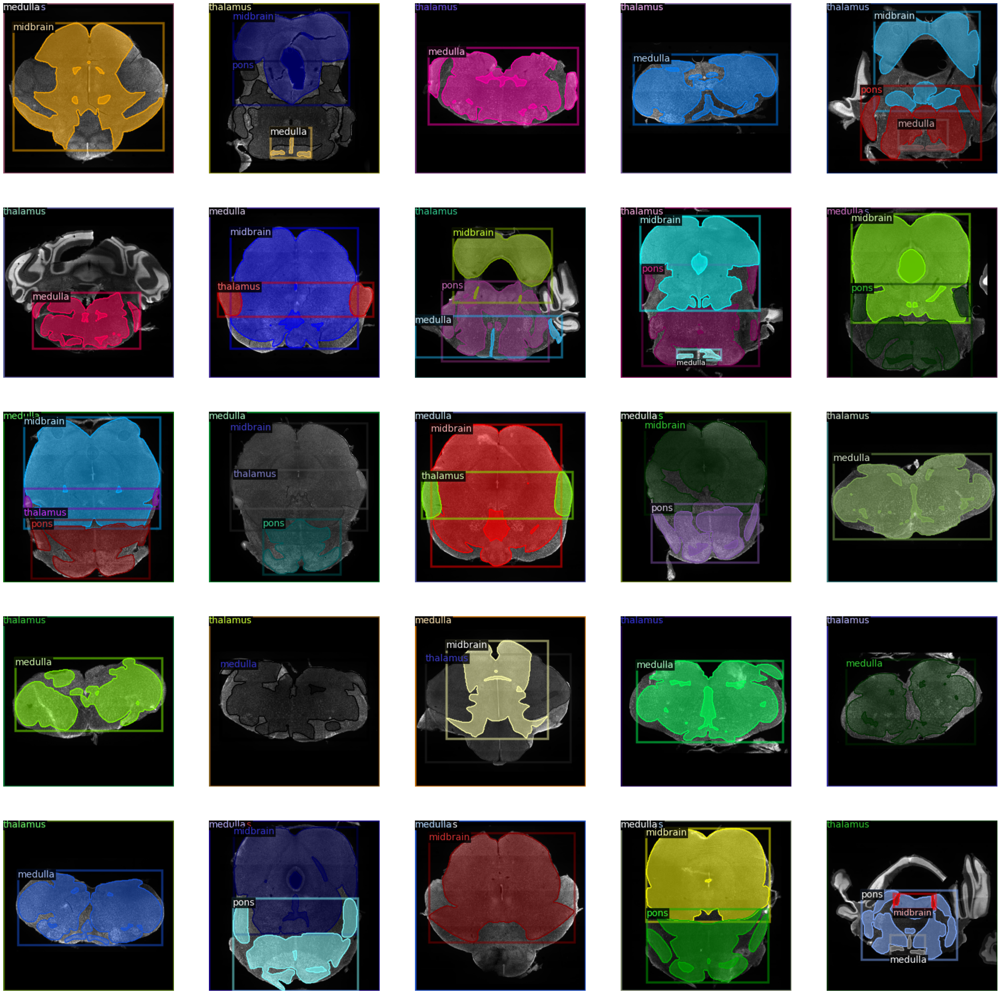

In [12]:
plt.figure(figsize=(40,40));
x=0
for d in random.sample(dataset_dicts, 25):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=mouse_metadata, scale=1)
    out = visualizer.draw_dataset_dict(d)
    plt.subplot(5,5,x+1)
    plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
    x+=1

### `Inference`
`testing a pre-trained model -  trained on 5000 iters`

In [46]:
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("mousenew_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000    # 1000 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # change it for the max number of classes for custom dataset
cfg.CHECKPOINT_PERIOD = 100 # save checkpoint after every 100th iteration
cfg.OUTPUT_DIR = '/content/drive/MyDrive/Cornell/Checkpoint/'

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[05/30 07:45:38 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Cornell/Checkpoint/model_final.pth ...


In [47]:
# preparing test data
dataset_dicts_test = get_custom_dataset(path, 'test')

processing:  1 / 10  sample
processing:  2 / 10  sample
processing:  3 / 10  sample
processing:  4 / 10  sample
processing:  5 / 10  sample
processing:  6 / 10  sample
processing:  7 / 10  sample
processing:  8 / 10  sample
processing:  9 / 10  sample
processing:  10 / 10  sample


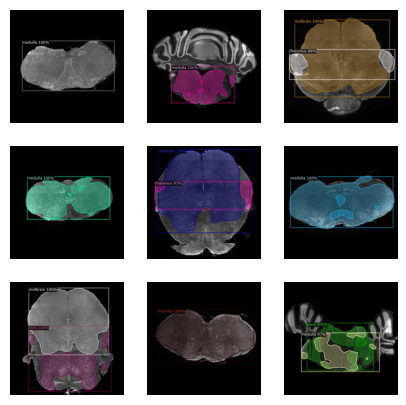

In [52]:
# visualizing results
grid = 3 #int(math.ceil(np.sqrt(np.shape(dataset_dicts_test)[0])))
from detectron2.utils.visualizer import ColorMode
plt.figure(figsize=(5,5))
x=0
for d in random.sample(dataset_dicts_test, 9):   
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=mouse_metadata, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.subplot(grid,grid,x+1)
    plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
    x+=1

### `Training (fine-tuning)`
```
*   loading a pre-trained model from model_zoo and finetune on mouse dataset
*   this may take some ⏰, grab a cup of ☕
```

In [31]:
cfg.OUTPUT_DIR

'/content/drive/MyDrive/Cornell/Checkpoint/MAX_ITER_1000'

In [33]:
from detectron2.engine import DefaultPredictor, DefaultTrainer
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("mousenew_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 10000    # 1000 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # change it for the max number of classes for custom dataset
cfg.CHECKPOINT_PERIOD = 100 # save checkpoint after every 100th iteration
cfg.OUTPUT_DIR = output_directory
if not os.path.exists(output_directory):
  os.makedirs(output_directory)
cfg.INPUT.MASK_FORMAT = 'bitmask'
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[05/30 06:23:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/30 06:23:40 d2.engine.train_loop]: Starting training from iteration 0
[05/30 06:23:48 d2.utils.events]:  eta: 1:04:59  iter: 19  total_loss: 2.759  loss_cls: 1.793  loss_box_reg: 0.2234  loss_mask: 0.6948  loss_rpn_cls: 0.0263  loss_rpn_loc: 0.01656    time: 0.4013  last_time: 0.3650  data_time: 0.0180  last_data_time: 0.0148   lr: 4.9953e-06  max_mem: 2529M
[05/30 06:23:56 d2.utils.events]:  eta: 1:04:43  iter: 39  total_loss: 2.531  loss_cls: 1.559  loss_box_reg: 0.1893  loss_mask: 0.6929  loss_rpn_cls: 0.06608  loss_rpn_loc: 0.02117    time: 0.3954  last_time: 0.4138  data_time: 0.0090  last_data_time: 0.0082   lr: 9.9902e-06  max_mem: 2529M
[05/30 06:24:04 d2.utils.events]:  eta: 1:05:33  iter: 59  total_loss: 2.108  loss_cls: 1.159  loss_box_reg: 0.1872  loss_mask: 0.6885  loss_rpn_cls: 0.01782  loss_rpn_loc: 0.01902    time: 0.4005  last_time: 0.3985  data_time: 0.0187  last_data_time: 0.0315   lr: 1.4985e-05  max_mem: 2529M
[05/30 06:24:12 d2.utils.events]:  eta: 1:05:17  it

### `Inference on custom-trained model`
`Observe the difference b/w results of previous (max_iter=5000) and this (max_iter=1000) model - previous one is better due to more training`

`Tip: Re-run the training for 5000+ epochs to achieve better results` 🐁

In [34]:
# preparing test data
dataset_dicts_test = get_custom_dataset(path, 'test')

processing:  1 / 10  sample
processing:  2 / 10  sample
processing:  3 / 10  sample
processing:  4 / 10  sample
processing:  5 / 10  sample
processing:  6 / 10  sample
processing:  7 / 10  sample
processing:  8 / 10  sample
processing:  9 / 10  sample
processing:  10 / 10  sample


In [53]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.9   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[05/30 07:46:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Cornell/Checkpoint/model_final.pth ...


### `max_iter = 10000`

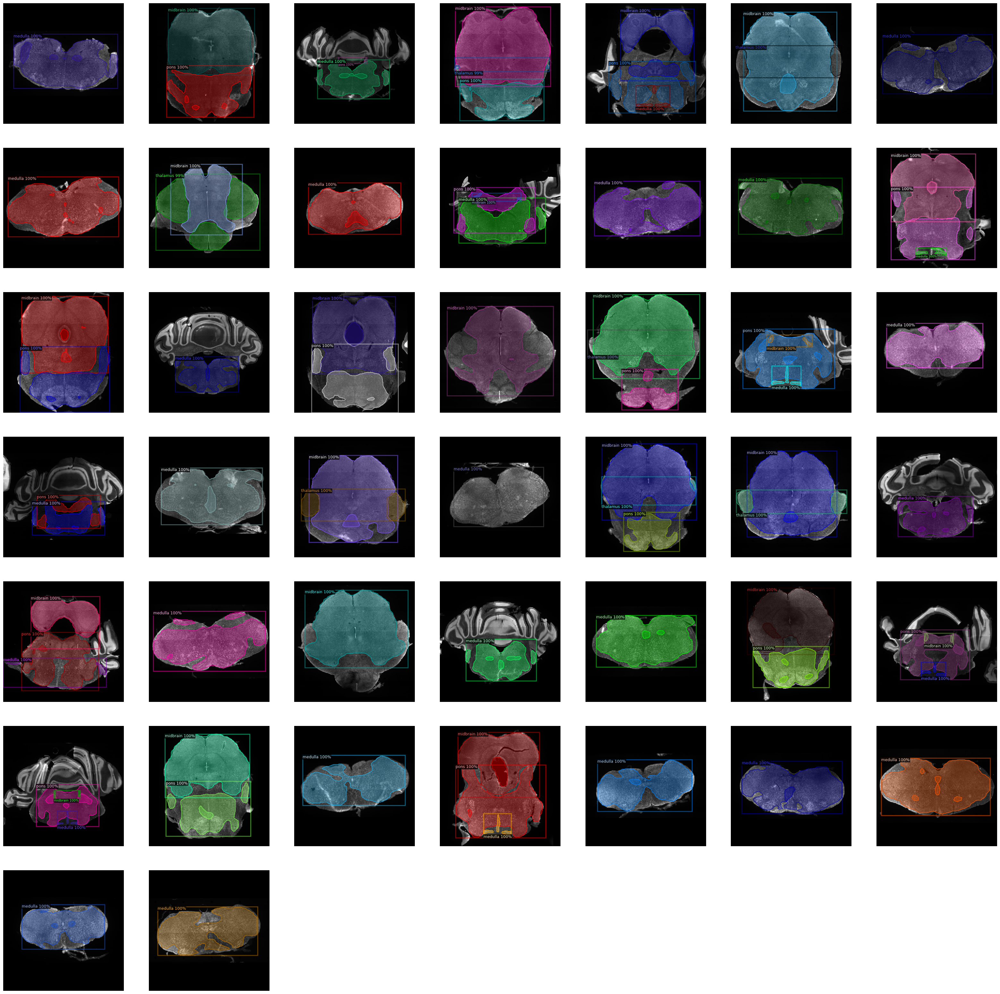

In [58]:
grid = 7 #int(math.ceil(np.sqrt(np.shape(dataset_dicts_test)[0])))
from detectron2.utils.visualizer import ColorMode
plt.figure(figsize=(40,40))
x=0
for d in random.sample(dataset_dicts, 44):   
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=mouse_metadata, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.subplot(grid,grid,x+1)
    plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
    x+=1

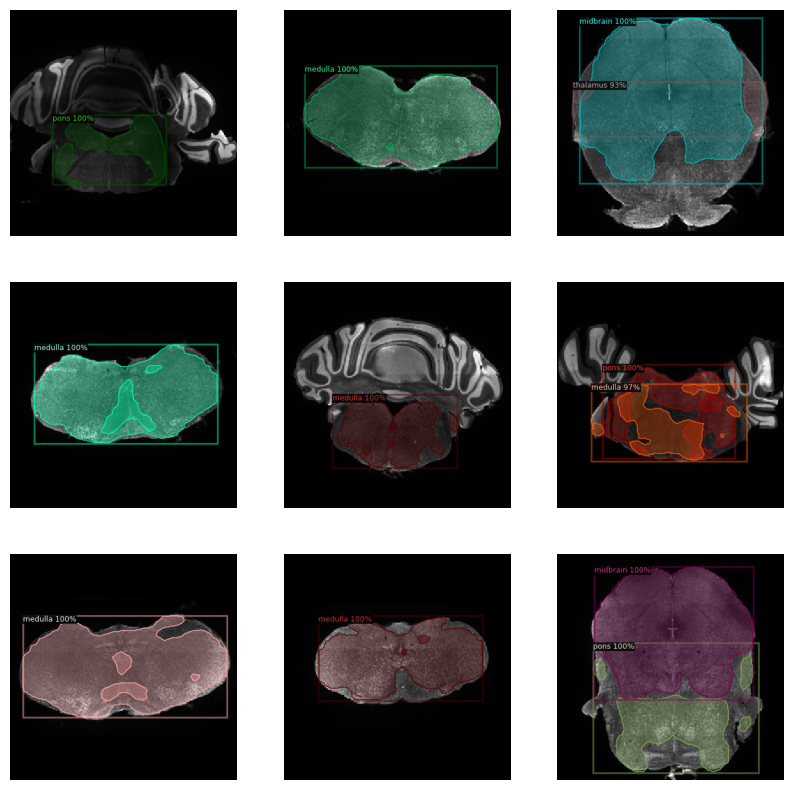

In [60]:
grid = 3 #int(math.ceil(np.sqrt(np.shape(dataset_dicts_test)[0])))
from detectron2.utils.visualizer import ColorMode
plt.figure(figsize=(10,10))
x=0
for d in random.sample(dataset_dicts_test, 9):   
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=mouse_metadata, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.subplot(grid,grid,x+1)
    plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
    x+=1

In [45]:
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:10.81


# `Allen data`

In [108]:
os.chdir('/content/drive/MyDrive/Cornell/Brainstem Registration/Allen Data/')
allen_folds = glob.glob('**')
print(len(allen_folds))

38


In [139]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[05/30 08:34:48 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Cornell/Checkpoint/model_final.pth ...


1 / 38  --- processed


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (91410432 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


2 / 38  --- processed
3 / 38  --- processed
4 / 38  --- processed
5 / 38  --- processed
6 / 38  --- processed
7 / 38  --- processed
8 / 38  --- processed
9 / 38  --- processed
10 / 38  --- processed
11 / 38  --- processed
12 / 38  --- processed
13 / 38  --- processed
14 / 38  --- processed
15 / 38  --- processed
16 / 38  --- processed
17 / 38  --- processed
18 / 38  --- processed
19 / 38  --- processed
20 / 38  --- processed
21 / 38  --- processed
22 / 38  --- processed
23 / 38  --- processed
24 / 38  --- processed
25 / 38  --- processed
26 / 38  --- processed
27 / 38  --- processed
28 / 38  --- processed
29 / 38  --- processed
30 / 38  --- processed
31 / 38  --- processed
32 / 38  --- processed


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (90661376 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


33 / 38  --- processed
34 / 38  --- processed
35 / 38  --- processed
36 / 38  --- processed


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:2918: DecompressionBombWarning: Image size (92784640 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


37 / 38  --- processed
38 / 38  --- processed


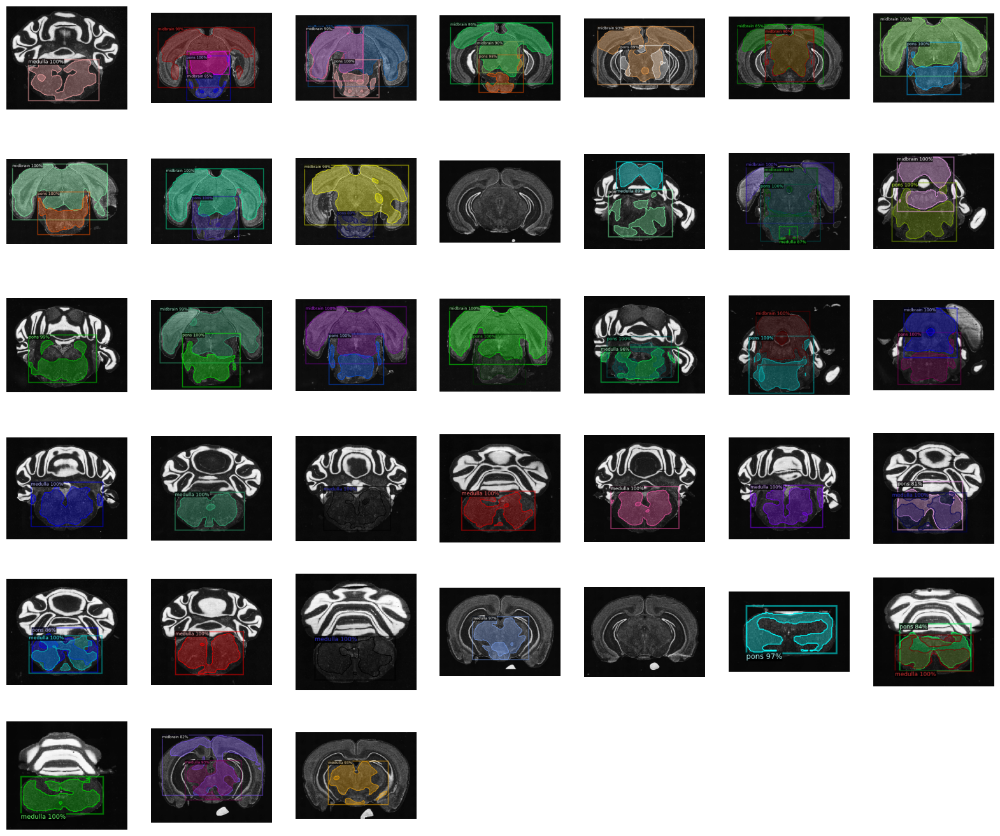

In [140]:
idx = 0
grid = math.ceil(np.sqrt(len(allen_folds)))
plt.figure(figsize=(20,20))
for idx in range(len(allen_folds)):
  os.chdir('/content/drive/MyDrive/Cornell/Brainstem Registration/Allen Data/'+allen_folds[idx])
  allen_file = glob.glob('*.jpg*')
  allen_temp = plt.imread('/content/drive/MyDrive/Cornell/Brainstem Registration/Allen Data/'+allen_folds[idx]+'/'+allen_file[0])
  #plt.imread('/content/drive/MyDrive/Cornell/Brainstem Registration/Allen Data/s99/100048576_393.jpg')

  scale_percent = 2.5
  width = int(allen_temp.shape[1] * scale_percent / 100); height = int(allen_temp.shape[0] * scale_percent / 100); dim = (width, height)
  resized = cv2.resize(allen_temp, dim, interpolation = cv2.INTER_AREA)
  resized = 1 - cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)
  resized_rgb = np.zeros((np.shape(resized)[0],np.shape(resized)[1],3))
  for x in range(3):
    resized_rgb[:,:,x] = resized
  resized_rgb/=np.max(resized_rgb)
  resized_rgb*=255
  #plt.figure(); plt.imshow(resized_rgb/255,cmap='gray')
  outputs = predictor(resized_rgb)
  v = Visualizer(resized_rgb[:, :, ::-1],
                  metadata=mouse_metadata, 
                  scale=1.5, 
                  instance_mode=ColorMode.IMAGE_BW
  )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.subplot(grid,grid,idx+1)
  plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
  print(idx+1,'/',len(allen_folds),' --- processed')

# `French data`

`A4`

1 / 29  --- processed
2 / 29  --- processed
3 / 29  --- processed
4 / 29  --- processed
5 / 29  --- processed
6 / 29  --- processed
7 / 29  --- processed
8 / 29  --- processed
9 / 29  --- processed
10 / 29  --- processed
11 / 29  --- processed
12 / 29  --- processed
13 / 29  --- processed
14 / 29  --- processed
15 / 29  --- processed
16 / 29  --- processed
17 / 29  --- processed
18 / 29  --- processed
19 / 29  --- processed
20 / 29  --- processed
21 / 29  --- processed
22 / 29  --- processed
23 / 29  --- processed
24 / 29  --- processed
25 / 29  --- processed
26 / 29  --- processed
27 / 29  --- processed
28 / 29  --- processed
29 / 29  --- processed


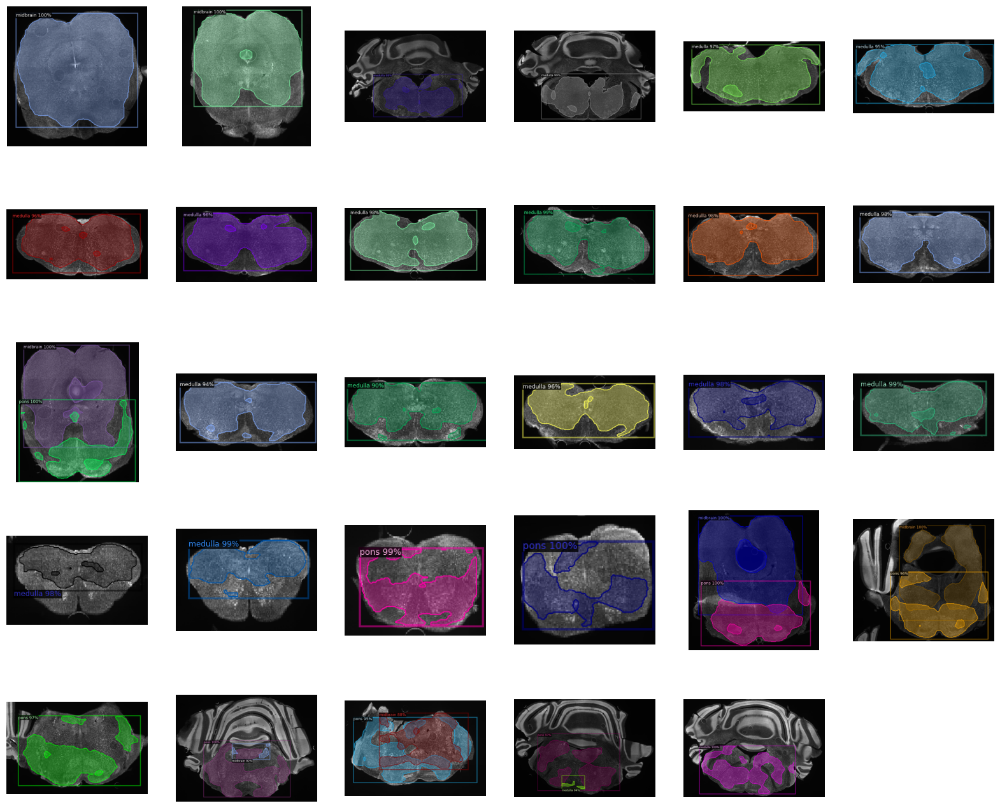

In [144]:
parent_path = '/content/drive/MyDrive/1 Asim Iqbal/Cornell/Brainstem Registration/Bouvier Lab Data (quant)/P2ABC1/TIF2/A4/Slices/Ch04/'
os.chdir(parent_path)
French_ch04_images = glob.glob('*.png*'); 
grid = math.ceil(np.sqrt(len(French_ch04_images)))

plt.figure(figsize=(20,20))
for idx in range(len(French_ch04_images)):
  french_temp = plt.imread(parent_path+French_ch04_images[idx])
  scale_percent = 7
  width = int(french_temp.shape[1] * scale_percent / 100); height = int(french_temp.shape[0] * scale_percent / 100); dim = (width, height)
  resized = cv2.resize(french_temp, dim, interpolation = cv2.INTER_AREA)
  resized_rgb = np.zeros((np.shape(resized)[0],np.shape(resized)[1],3))
  for x in range(3):
    resized_rgb[:,:,x] = resized
  resized_rgb/=np.max(resized_rgb)
  resized_rgb*=255
  #plt.imshow(resized_rgb/255)
  #plt.figure(); plt.imshow(resized_rgb/255,cmap='gray')
  outputs = predictor(resized_rgb)
  v = Visualizer(resized_rgb[:, :, ::-1],
                  metadata=mouse_metadata, 
                  scale=1.5, 
                  instance_mode=ColorMode.IMAGE_BW
  )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.subplot(grid,grid,idx+1)
  plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
  print(idx+1,'/',len(French_ch04_images),' --- processed')

### `A7`

1 / 28  --- processed
2 / 28  --- processed
3 / 28  --- processed
4 / 28  --- processed
5 / 28  --- processed
6 / 28  --- processed
7 / 28  --- processed
8 / 28  --- processed
9 / 28  --- processed
10 / 28  --- processed
11 / 28  --- processed
12 / 28  --- processed
13 / 28  --- processed
14 / 28  --- processed
15 / 28  --- processed
16 / 28  --- processed
17 / 28  --- processed
18 / 28  --- processed
19 / 28  --- processed
20 / 28  --- processed
21 / 28  --- processed
22 / 28  --- processed
23 / 28  --- processed
24 / 28  --- processed
25 / 28  --- processed
26 / 28  --- processed
27 / 28  --- processed
28 / 28  --- processed


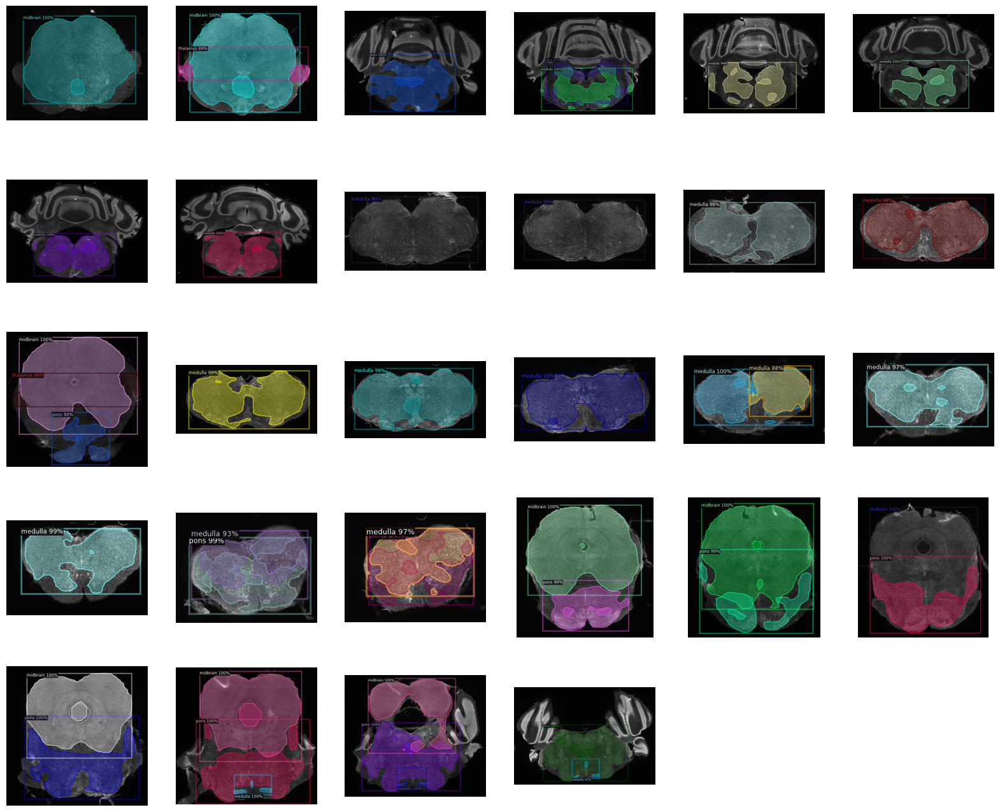

In [148]:
parent_path = '/content/drive/MyDrive/1 Asim Iqbal/Cornell/Brainstem Registration/Bouvier Lab Data (quant)/P2ABC1/TIF2/A7/Slices/Ch04/'
os.chdir(parent_path)
French_ch04_images = glob.glob('*.png*'); 
grid = math.ceil(np.sqrt(len(French_ch04_images)))

plt.figure(figsize=(20,20))
for idx in range(len(French_ch04_images)):
  french_temp = plt.imread(parent_path+French_ch04_images[idx])
  scale_percent = 7
  width = int(french_temp.shape[1] * scale_percent / 100); height = int(french_temp.shape[0] * scale_percent / 100); dim = (width, height)
  resized = cv2.resize(french_temp, dim, interpolation = cv2.INTER_AREA)
  resized_rgb = np.zeros((np.shape(resized)[0],np.shape(resized)[1],3))
  for x in range(3):
    resized_rgb[:,:,x] = resized
  resized_rgb/=np.max(resized_rgb)
  resized_rgb*=255
  #plt.imshow(resized_rgb/255)
  #plt.figure(); plt.imshow(resized_rgb/255,cmap='gray')
  outputs = predictor(resized_rgb)
  v = Visualizer(resized_rgb[:, :, ::-1],
                  metadata=mouse_metadata, 
                  scale=1.5, 
                  instance_mode=ColorMode.IMAGE_BW
  )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  plt.subplot(grid,grid,idx+1)
  plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
  print(idx+1,'/',len(French_ch04_images),' --- processed')

### `max_iter = 1000`

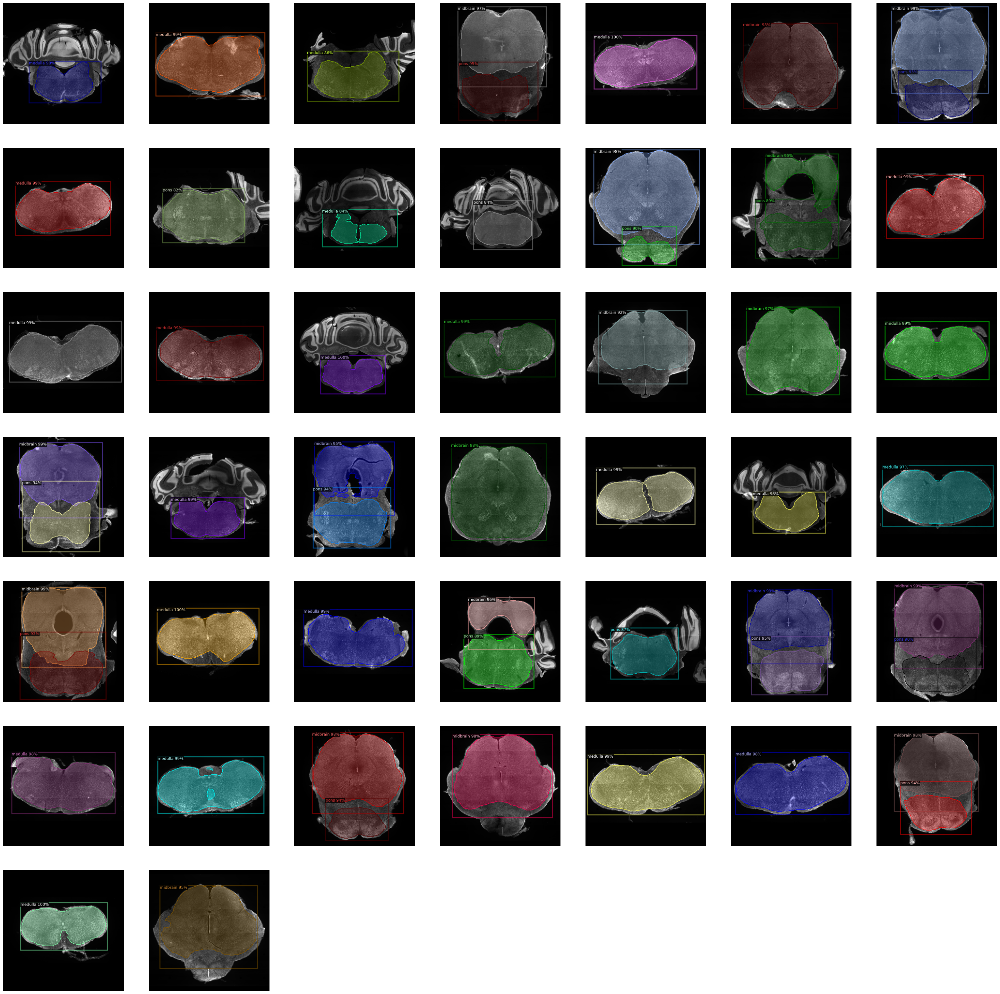

In [26]:
grid = 7 #int(math.ceil(np.sqrt(np.shape(dataset_dicts_test)[0])))
from detectron2.utils.visualizer import ColorMode
plt.figure(figsize=(40,40))
x=0
for d in random.sample(dataset_dicts, 44):   
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=mouse_metadata, 
                   scale=1.5, 
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.subplot(grid,grid,x+1)
    plt.imshow(out.get_image()[:, :, ::-1]); plt.axis('off')
    x+=1

`inference time`

In [ ]:
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.10,fps:10.22
